I pre-processed this mouse stroke single cell dataset previously by ScanPy.\
Here, I will pre-process it using Seurat, scCustomize and some bioconductor packages.\
I intend to do some in-depth exploratory analysis on the data. In ScanPy analysis,\
I observed some batch effects and performed integration by scvi-tools. I also transferred\
these embeddings to the Seurat object from the anndata object.

I will use some command and analysis approaches from the PART_4A notebook\
such as scater::plotExplanatoryVariables, and scran::modelGeneVar. 

THIRD PART OF PART_4B NOTEBOOK !!!!

In [270]:
# Now I will write a function to view all continuous variable plots pairwise 
# with desired discrete variable plot:

plot_continuous_vars_w_ref <- function(seurat_object, continuous_vars, ref_feature, my_reduction, my_colours, my_margin) { 


continuous_vars <- setdiff(continuous_vars, ref_feature)
    
plot_list_continuous_vars <- list()

 plot_REF <- 
        DimPlot(object = seurat_object,
            shuffle = TRUE,
            cols = my_colours,
            reduction = my_reduction, 
            group.by =  ref_feature) + my_margin
    
for (each_feature in continuous_vars) {

 plot_list_continuous_vars[[each_feature]] <- 
        FeaturePlot(object = seurat_object,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = my_reduction, 
            features =  each_feature) + my_margin

 plot_list_continuous_vars[[paste0('ref_', ref_feature, '_plot_for_', each_feature)]] <- plot_REF

}
     
    return(plot_list_continuous_vars)
    
}

In [273]:
plot_list_continuous_vars_COMPARED <- plot_continuous_vars_w_ref(seurat_object = zheng_et_al_seurat, 
                                               ref_feature = 'sample',
                                               my_reduction = 'XscVImde_', 
                                               continuous_var = continuous_vars, 
                                               my_colours = my_colours, 
                                               my_margin = my_margin)

In [274]:
plot_list_continuous_vars_COMPARED |> names()

[1] "nCount_RNA"                                     
 [2] "ref_sample_plot_for_nCount_RNA"                 
 [3] "nFeature_RNA"                                   
 [4] "ref_sample_plot_for_nFeature_RNA"               
 [5] "n_genes_by_counts"                              
 [6] "ref_sample_plot_for_n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"                        
 [8] "ref_sample_plot_for_log1p_n_genes_by_counts"    
 [9] "total_counts"                                   
[10] "ref_sample_plot_for_total_counts"               
[11] "log1p_total_counts"                             
[12] "ref_sample_plot_for_log1p_total_counts"         
[13] "pct_counts_in_top_50_genes"                     
[14] "ref_sample_plot_for_pct_counts_in_top_50_genes" 
[15] "pct_counts_in_top_100_genes"                    
[16] "ref_sample_plot_for_pct_counts_in_top_100_genes"
[17] "pct_counts_in_top_200_genes"                    
[18] "ref_sample_plot_for_pct_counts_in_top_200_genes"
[19] "pct_counts_in_top_500_genes"                    
[20] "ref_sample_plot_for_pct_counts_in_top_500_genes"
[21] "n_genes"                                        
[22] "ref_sample_plot_for_n_genes"                    
[23] "doublet_score"                                  
[24] "ref_sample_plot_for_doublet_score"              
[25] "percent_mito"                                   
[26] "ref_sample_plot_for_percent_mito"               
[27] "percent_ribo"                                   
[28] "ref_sample_plot_for_percent_ribo"               
[29] "percent_mito_ribo"                              
[30] "ref_sample_plot_for_percent_mito_ribo"          
[31] "log10GenesPerUMI"                               
[32] "ref_sample_plot_for_log10GenesPerUMI"           
[33] "percent_top50"                                  
[34] "ref_sample_plot_for_percent_top50"              
[35] "percent_oxphos"                                 
[36] "ref_sample_plot_for_percent_oxphos"             
[37] "percent_apop"                                   
[38] "ref_sample_plot_for_percent_apop"               
[39] "percent_dna_repair"                             
[40] "ref_sample_plot_for_percent_dna_repair"         
[41] "percent_ieg"                                    
[42] "ref_sample_plot_for_percent_ieg"                
[43] "percent_hemo"                                   
[44] "ref_sample_plot_for_percent_hemo"               
[45] "S.Score"                                        
[46] "ref_sample_plot_for_S.Score"                    
[47] "G2M.Score"                                      
[48] "ref_sample_plot_for_G2M.Score"

In [276]:
# equalize the scale of axes:

plot_list_continuous_vars_COMPARED_CORRECTED <- list()

for (each_plot in names(plot_list_continuous_vars_COMPARED)) {

    plot_list_continuous_vars_COMPARED_CORRECTED[[each_plot]] <- 
            plot_list_continuous_vars_COMPARED[[each_plot]] + my_scVI_mde_coords

    }

In [277]:
rm(plot_list_continuous_vars_COMPARED)

In [278]:
total_plots <- length(plot_list_continuous_vars_COMPARED_CORRECTED)
plot_per_col <- 2

In [279]:
options(repr.plot.width = 9*plot_per_col, repr.plot.height = 7*(total_plots/2))

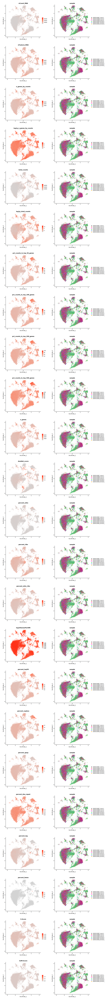

In [281]:
patchwork::wrap_plots(plot_list_continuous_vars_COMPARED_CORRECTED, ncol = plot_per_col)

NOTE: Instead of for loops to adjust axes scales, lapply can also be used without\
needing to create a new variable to apply same coordinate plane to all plots in the list:

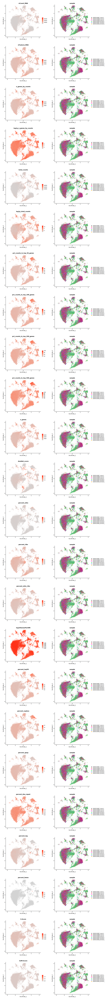

In [282]:
plot_list_continuous_vars_COMPARED <- plot_continuous_vars_w_ref(seurat_object = zheng_et_al_seurat, 
                                               ref_feature = 'sample',
                                               my_reduction = 'XscVImde_', 
                                               continuous_var = continuous_vars, 
                                               my_colours = my_colours, 
                                               my_margin = my_margin)

# Apply coord_cartesian to each plot in the list
plot_list_continuous_vars_COMPARED <- lapply(plot_list_continuous_vars_COMPARED, function(each_plot) {
  each_plot + my_scVI_mde_coords
})

total_plots <- length(plot_list_continuous_vars_COMPARED)
plot_per_col <- 2

options(repr.plot.width = 9*plot_per_col, repr.plot.height = 7*(total_plots/2))

patchwork::wrap_plots(plot_list_continuous_vars_COMPARED , ncol = plot_per_col)

In [283]:
zheng_et_al_seurat %>% 
    saveRDS(here::here('r_objects', 'zheng_et_al_seurat_w_qc_metrics.RDS'))

===========================

Next, using scCustomize, I will continue with qc metrics\
visualizations as violin plots etc.\
Especially, I will look at distribution of those metrics and\
and if necessary, I will filter out the outlier and low quality cells.\
After that, I will find clusters and annotate cell types.

In [284]:
sessionInfo()

R version 4.4.2 (2024-10-31)
Platform: x86_64-unknown-linux-gnu
Running under: Red Hat Enterprise Linux 9.4 (Plow)

Matrix products: default
BLAS/LAPACK: /gnu/store/mj1kw87qd3m1q7r4844adkn5hifx8k6a-openblas-0.3.20/lib/libopenblasp-r0.3.20.so;  LAPACK version 3.9.0

locale:
 [1] LC_CTYPE=C          LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C.UTF-8
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Europe/Berlin
tzcode source: system (glibc)

attached base packages:
[1] stats4    stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] ensembldb_2.30.0        AnnotationFilter_1.30.0 GenomicFeatures_1.58.0 
 [4] AnnotationDbi_1.68.0    Biobase_2.66.0          GenomicRanges_1.58.0   
 [7] GenomeInfoDb_1.42.0     IRanges_2.40.0          S4Vectors_0.44.0       
[10] AnnotationHub_3.14.0    BiocFileCac